## 0. Introduction

### 0.1. Google Colab

In [191]:
# Mounting a google drive for Google Colab
# from google.colab import drive
# drive.mount('/content/drive')

### 0.2. Import

In [291]:
# Import dependencies
import time
import random
import warnings
from itertools import combinations_with_replacement

# Standard Data manipulation
import numpy as np
import pandas as pd
import skimpy
import pickle

# Plotting
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import ListedColormap
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Scikit-learn
import sklearn
from matplotlib.colors import LinearSegmentedColormap

sklearn.set_config(enable_metadata_routing=True)

from sklearn.linear_model import (LogisticRegression, LogisticRegressionCV, RidgeClassifierCV, SGDClassifier, RidgeCV)
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, HistGradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import plot_tree
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier, NeighborhoodComponentsAnalysis
from sklearn.model_selection import (train_test_split, GridSearchCV, RandomizedSearchCV) #Use for CPU-based calculations
from sklearn.manifold import TSNE


from sklearn.metrics import (confusion_matrix, ConfusionMatrixDisplay, roc_curve, RocCurveDisplay, auc, make_scorer, accuracy_score, silhouette_samples, silhouette_score)
from sklearn.pipeline import Pipeline

from sklearn.utils._testing import ignore_warnings

from imblearn.over_sampling import SMOTE
from collections import Counter

# Cluster evaluation
from clusteval import clusteval

# Shapley
import shap

# # GPU-based Calculations
# import cupy
# import cudf # DataFrame for GPU

# import cuml
# from cuml.model_selection import train_test_split as train_test_split_GPU
# from cuml.linear_model import LogisticRegression as LogisticRegression_GPU
# from cuml.ensemble import RandomForestClassifier as RandomForestClassifier_GPU
# from cuml.metrics import confusion_matrix as confusion_matrix_GPU

# XGBoost
import xgboost as xgb

# Graphviz
import graphviz

# Dask-ML
import dask_ml.model_selection as dcv
from dask.distributed import (LocalCluster, Client)
import joblib


# import gzip


In [193]:
# import warnings filter
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)

In [194]:
# Constant Variables
random_state, random_seed = 25 ,25

## 1. Data import

In [195]:
# Importing the data for Google Colab
# test_data = pd.read_csv('/content/drive/MyDrive/_Temp_DataScience/ISA/Projekt ML/testing_sample.csv')
# train_data = pd.read_csv('/content/drive/MyDrive/_Temp_DataScience/ISA/Projekt ML/training_sample.csv')

# Importing the data for local machine
test_data = pd.read_csv('testing_sample.csv')
train_data = pd.read_csv('training_sample.csv')

In [196]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 455401 entries, 0 to 455400
Data columns (total 25 columns):
 #   Column                   Non-Null Count   Dtype 
---  ------                   --------------   ----- 
 0   UserID                   455401 non-null  object
 1   basket_icon_click        455401 non-null  int64 
 2   basket_add_list          455401 non-null  int64 
 3   basket_add_detail        455401 non-null  int64 
 4   sort_by                  455401 non-null  int64 
 5   image_picker             455401 non-null  int64 
 6   account_page_click       455401 non-null  int64 
 7   promo_banner_click       455401 non-null  int64 
 8   detail_wishlist_add      455401 non-null  int64 
 9   list_size_dropdown       455401 non-null  int64 
 10  closed_minibasket_click  455401 non-null  int64 
 11  checked_delivery_detail  455401 non-null  int64 
 12  checked_returns_detail   455401 non-null  int64 
 13  sign_in                  455401 non-null  int64 
 14  saw_checkout        

```UserID``` Column will not be needed

In [197]:
test_data = test_data.drop(['UserID'], axis = 1)
train_data = train_data.drop(['UserID'], axis = 1)

**Cleaning the DataFrame - only the information in which the visitor made the action on the website.**

In [198]:
no_action_columns = [
    'device_mobile',
    'device_computer',
    'device_tablet',    
    'returning_user',
    'loc_uk',
    'ordered'
]

In [199]:
df_cleaned = train_data[~(train_data.loc[:, ~train_data.columns.isin(no_action_columns)] == 0).all(axis=1)]
df_cleaned.shape

(220061, 24)

In [200]:
df_all_data = df_cleaned.copy()

**Spliting the Data**

In [201]:
df_train_clean = df_cleaned.sort_values(by='ordered', ascending= False).reset_index(drop=True)

# list of names + separation of test collection
names = ['Ada', 'Darek', 'Grzesiek', 'Ola', 'test']
no_of_orders = df_train_clean["ordered"].sum()


# name selection function
def get_name(index):
    return names[index % len(names)]

# add a new column - ordered = 1 - everyone (with the test set separated), ordered = 0 - one by one names

df_train_clean['who'] = df_train_clean.apply(lambda row: get_name(row.name) if row['ordered'] == 0 else ('test' if row.name < no_of_orders * 0.2 else 'wszyscy'), axis=1)

In [202]:
df_train_clean.who[df_train_clean['ordered'] == 0].value_counts()

who
Ola         40194
test        40194
Ada         40194
Darek       40193
Grzesiek    40193
Name: count, dtype: int64

In [203]:
df_train_clean.who.value_counts()

who
test        44013
Ola         40194
Ada         40194
Darek       40193
Grzesiek    40193
wszyscy     15274
Name: count, dtype: int64

In [204]:
# Let's check the proportion of orders in the entire df_train_clean set and in the set spun out for testing

orders_to_total_all = df_train_clean['ordered'].sum() / df_train_clean['ordered'].count()
orders_to_total_test = df_train_clean['ordered'][df_train_clean['who'] == 'test'].sum() / df_train_clean['ordered'][df_train_clean['who'] == 'test'].count()

print(f'percentage of total orders df_train_clean {orders_to_total_all}')
print(f'percentage of orders in test df_train_clean {orders_to_total_test}')

percentage of total orders df_train_clean 0.0867623068149286
percentage of orders in test df_train_clean 0.08676981800831572


In [205]:
# creating a database for a specific person - just change your name
df = df_train_clean[df_train_clean['who'].isin(['wszyscy', 'Grzesiek'])].drop(columns=['who'], axis=1)

In [206]:
df.describe(include='all').T

,count,mean,std,min,25%,50%,75%,max
basket_icon_click,55467.0,0.309301,0.462210,0.0,0.0,0.0,1.0,1.0
basket_add_list,55467.0,0.213082,0.409489,0.0,0.0,0.0,0.0,1.0
basket_add_detail,55467.0,0.339697,0.473611,0.0,0.0,0.0,1.0,1.0
sort_by,55467.0,0.077902,0.268020,0.0,0.0,0.0,0.0,1.0
image_picker,55467.0,0.060577,0.238554,0.0,0.0,0.0,0.0,1.0
account_page_click,55467.0,0.010385,0.101375,0.0,0.0,0.0,0.0,1.0
promo_banner_click,55467.0,0.036941,0.188618,0.0,0.0,0.0,0.0,1.0
detail_wishlist_add,55467.0,0.007770,0.087807,0.0,0.0,0.0,0.0,1.0
list_size_dropdown,55467.0,0.487695,0.499853,0.0,0.0,0.0,1.0,1.0
closed_minibasket_click,55467.0,0.050571,0.219121,0.0,0.0,0.0,0.0,1.0


**Translation the column names in polish**

The names will be changed at the end - for Prezi online presentations. English will be used in the notebook.

In [207]:
column_mapping = {
    'UserID': 'ID_uzytkownika',
    'basket_icon_click': 'klik_ikony_koszyka',
    'basket_add_list': 'dodanie_do_koszyka_z_listy',
    'basket_add_detail': 'dodanie_do_koszyka_z_detali',
    'sort_by': 'sortowanie_produktu',
    'image_picker': 'wybor_obrazu',
    'account_page_click': 'klik_na_strone_konta',
    'promo_banner_click': 'klik_na_baner_promo',
    'detail_wishlist_add': 'dodanie_do_listy_zyczen_z_detali',
    'list_size_dropdown': 'rozwijana_lista_produktu',
    'closed_minibasket_click': 'zamkniecie_mini_koszyka',
    'checked_delivery_detail': 'sprawdzenie_info_dostawy_produkt',
    'checked_returns_detail': 'sprawdzenie_info_zwrotu',
    'sign_in': 'logowanie',
    'saw_checkout': 'wyswietlenie_realizacji_zamowienia',
    'saw_sizecharts': 'wyswietlenie_tabeli_rozmiarow',
    'saw_delivery': 'wyswietlenie_info_o_dostawie_FAQ',
    'saw_account_upgrade': 'wyswietlenie_opcji_upgrade_konta',
    'saw_homepage': 'wyswietlenie_strony_glownej',
    'device_mobile': 'urzadzenie_mobilne', 
    'device_computer': 'komputer', 
    'device_tablet': 'tablet',
    'returning_user': 'powracajcy_klient', 
    'loc_uk': 'lokalizacja_uk',
    'ordered': 'zlozone_zamownie'
}

# renaming columns
# df_train = df_train.rename(columns=column_mapping)

## 3. Machine Learning

### Helping functions

In [208]:
def do_HPO(model, gridsearch_params, scorer, X, y, mode="gpu-Grid", n_iter=10):
    if mode == "gpu-grid":
        print("gpu-grid selected")
        clf = dcv.GridSearchCV(
            model, gridsearch_params, cv=5, scoring=scorer)
    elif mode == "gpu-random":
        print("gpu-random selected")
        clf = dcv.RandomizedSearchCV(
            model, gridsearch_params, cv=5, scoring=scorer, n_iter=n_iter
        )
    elif mode == "cpu-grid":
        print("cpu-grid selected")
        clf = GridSearchCV(
            model, gridsearch_params, cv=5, scoring=scorer)
    elif mode == "cpu-random":
        print("cpu-random selected")
        clf = RandomizedSearchCV(
            model, gridsearch_params, cv=5, scoring=scorer, n_iter=n_iter
        )
    else:
        print("Unknown Option, please choose one of [gpu-grid, gpu-random, cpu-grid, cpu-random]")
        return None, None
    res = clf.fit(X, y)
    
    print("Searched over {} parameters\n".format(len(res.cv_results_["mean_test_score"])))

    print("Best parameters:", res.best_params_)  
    print("Best estimator and score {} {}\n---\n".format(res.best_estimator_, res.best_score_))
    return res.best_estimator_, res

In [209]:
def accuracy_score_wrapper(y, y_hat):
    """
    A wrapper function to convert labels to float32,
    and pass it to accuracy_score.

    Params:
    - y: The y labels that need to be converted
    - y_hat: The predictions made by the model
    """
    y = y.astype("float32")  # cuML RandomForest needs the y labels to be float32
    return accuracy_score(y, y_hat, convert_dtype=True)


accuracy_wrapper_scorer = make_scorer(accuracy_score_wrapper)
cuml_accuracy_scorer = make_scorer(accuracy_score, convert_dtype=True)

In [210]:
def print_acc(model, X_Train, y_train, X_test, y_test, mode_str="Default"):
    """
    Trains a model on the train data provided, and prints the accuracy of the trained model.
    mode_str: User specifies what model it is to print the value
    """
    y_pred = model.fit(X_Train, y_train).predict(X_test)
    score = accuracy_score(y_pred, y_test.astype("float32"), convert_dtype=True)
    print("{} model accuracy: {}".format(mode_str, score))

In [211]:
from contextlib import contextmanager

# Helping time blocks of code
@contextmanager
def timed(txt):
    t0 = time.time()
    yield
    t1 = time.time()
    print("%32s time:  %8.5f" % (txt, t1 - t0))

**Starting Cluster Client for CPU parallel acceleration**

In [212]:
cluster = LocalCluster(n_workers=12,threads_per_worker=2)
client = Client(cluster)

client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:63569/status,
Dashboard: http://127.0.0.1:63569/status,Workers: 12
Total threads: 24,Total memory: 63.21 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:63610,Workers: 12
Dashboard: http://127.0.0.1:63569/status,Total threads: 24
Started: Just now,Total memory: 63.21 GiB
Comm: tcp://127.0.0.1:63736,Total threads: 2
Dashboard: http://127.0.0.1:63762/status,Memory: 5.27 GiB
Nanny: tcp://127.0.0.1:63620,


In [213]:
# client.close()
client.status

'running'

### Data Preparation

In [214]:
# Spliting the data into X and y train/test variables
X = df.iloc[:,:-1].copy()
y = df.iloc[:,-1].copy()
X_Train, X_Test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [215]:
# Checking the stratification
print(len(X_Train[y_train == 1])/len(y_train))
print(len(X_Test[y_test == 1])/len(y_test))

0.27537015752822663
0.2753740760771588


### Logistic Regression

In [216]:
# weight for balancing the unbalanced dataset
weight_ordered = 1/(y_train.sum()/len(y_train))
print(weight_ordered)

# Weight for Logistic Regression
lr_weight = {0: 1, 1: 4} # Multiply Ordered == Yes by 4

3.6314755708323103


In [217]:
model_LR = LogisticRegressionCV(Cs = 20,
                                penalty='l1',
                                fit_intercept=False,
                                class_weight = lr_weight,
                                random_state = 42,
                                solver='liblinear',
                                max_iter=1000000,
                                multi_class='ovr',
                                n_jobs=-1,
                                verbose=0
                                )
model_LR

LogisticRegressionCV(Cs=20, class_weight={0: 1, 1: 4}, fit_intercept=False,
                     max_iter=1000000, multi_class='ovr', n_jobs=-1,
                     penalty='l1', random_state=42, solver='liblinear')

In [218]:
with joblib.parallel_backend('dask'):
    start_time = time.time()
    model_LR.fit(X_Train,y_train)
    end_time = time.time()
    
    time_taken = end_time - start_time
    print(f'time to execute:{time_taken}')

time to execute:3.380192756652832


In [219]:
y_pred = model_LR.predict(X_Test)

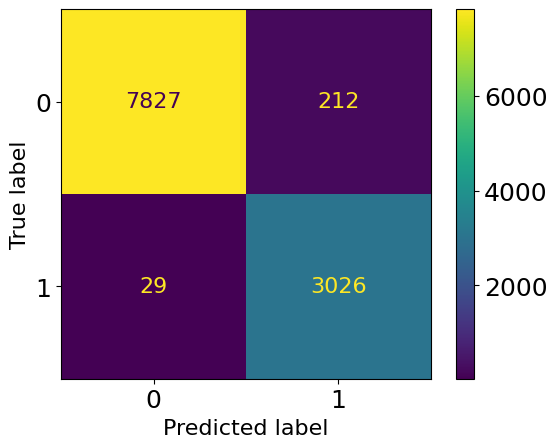

In [220]:
cmtrx = confusion_matrix(y_test, y_pred, labels=model_LR.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=model_LR.classes_)
disp.plot()
plt.show()

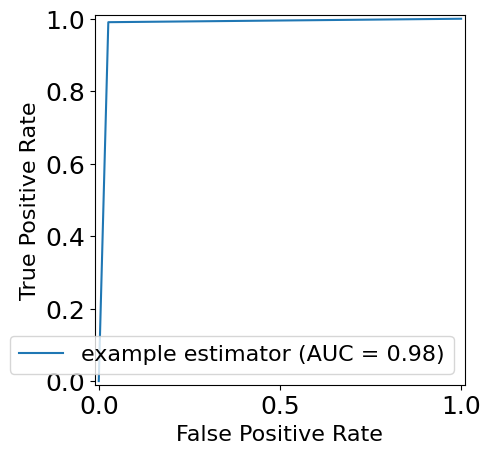

In [221]:
def plot_roc_curve(y_true, y_pred):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)
    display = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                      estimator_name='example estimator')
    display.plot()
    plt.show()
    
plot_roc_curve(y_test, y_pred)

**Hyperparameter Optimization**.

In [222]:
params_LR = {
            'Cs': range(15,25,5),              # Default value is 10
            'fit_intercept': [True,False],        # Default value is True
            # 'cv': None,                   # Default value is None
            # 'dual': False,                # Default value is False
            'penalty': [                    # Default value is 'l2'
                        'l1',
                        'l2',
                        'elasticnet'
                        ],
            # 'scoring': None,              # Default value is None
            'solver': [                     # Default value is 'lbfgs'
                        'lbfgs',
                        'liblinear',
                        'newton-cg',
                        'newton-cholesky',
                        'sag',
                        'saga'
                        ],
            # 'tol': 0.0001,                # Default value is 0.0001
            # 'max_iter': 100,              # Default value is 100
            # 'class_weight': None,         # Default value is None
            # 'n_jobs': None,               # Default value is None
            # 'verbose': 0,                 # Default value is 0
            # 'refit': True,                # Default value is True
            # 'intercept_scaling': 1.0,     # Default value is 1.0
            # 'multi_class': 'auto',        # Default value is 'auto'
            # 'random_state': None,         # Default value is None
            # 'l1_ratios': None             # Default value is None
}

In [43]:
with joblib.parallel_backend('dask'):
    res, results = do_HPO(
          model = model_LR,
          gridsearch_params = params_LR,
          X = X_Train,
          y = y_train,
          mode ='cpu-grid',
          scorer = None,
          n_iter = 10
      )

cpu-grid selected


e:\_DataScience\_Python_venvs\std_env\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
200 fits failed out of a total of 360.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
20 fits failed with the following error:
Traceback (most recent call last):
  File "e:\_DataScience\_Python_venvs\std_env\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "e:\_DataScience\_Python_venvs\std_env\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "e:\_DataScience\_Python_venvs\std_env\Lib\site-packages\sklearn\linear

Searched over 72 parameters

Best parameters: {'Cs': 15, 'fit_intercept': True, 'penalty': 'l1', 'solver': 'liblinear'}
Best estimator and score LogisticRegressionCV(Cs=15, class_weight={0: 1, 1: 4}, max_iter=1000000,
                     multi_class='ovr', n_jobs=-1, penalty='l1',
                     random_state=42, solver='liblinear') 0.9864106809892486
---



### Random Forest

In [45]:
rfc_cpu = RandomForestClassifier(max_depth=7,
                             max_leaf_nodes=100,
                             min_samples_split=10,
                             n_estimators=200,
                             class_weight=lr_weight,
                             n_jobs=-1,
                             random_state=42,
                             verbose=0)

In [46]:
rfc_cpu.fit(X_Train,y_train)

RandomForestClassifier(class_weight={0: 1, 1: 4}, max_depth=7,
                       max_leaf_nodes=100, min_samples_split=10,
                       n_estimators=200, n_jobs=-1, random_state=42)

In [47]:
rfc_cpu.score(X_Test,y_test)

0.9840454299621417

In [48]:
y_pred = rfc_cpu.predict(X_Test)

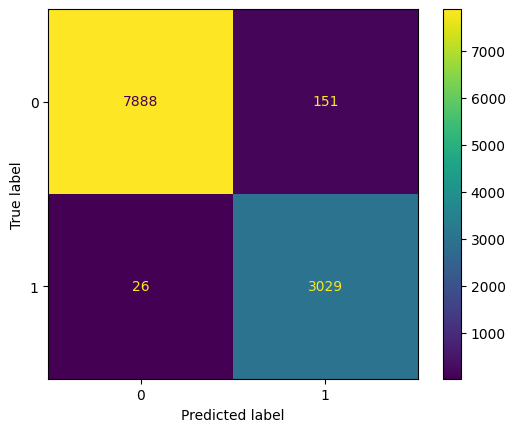

In [49]:
cmtrx = confusion_matrix(y_test, y_pred, labels=rfc_cpu.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=rfc_cpu.classes_)
disp.plot()
plt.show()

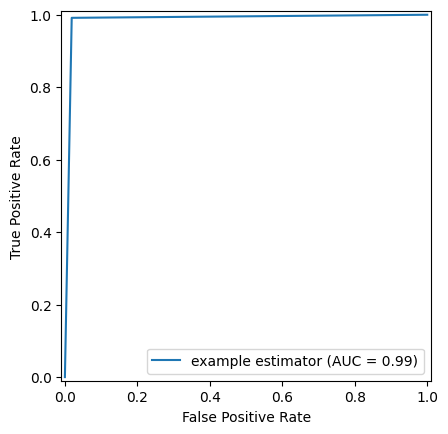

In [50]:
def plot_roc_curve(y_true, y_pred):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)
    display = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc,
                                      estimator_name='example estimator')
    display.plot()
    plt.show()
    
plot_roc_curve(y_test, y_pred)

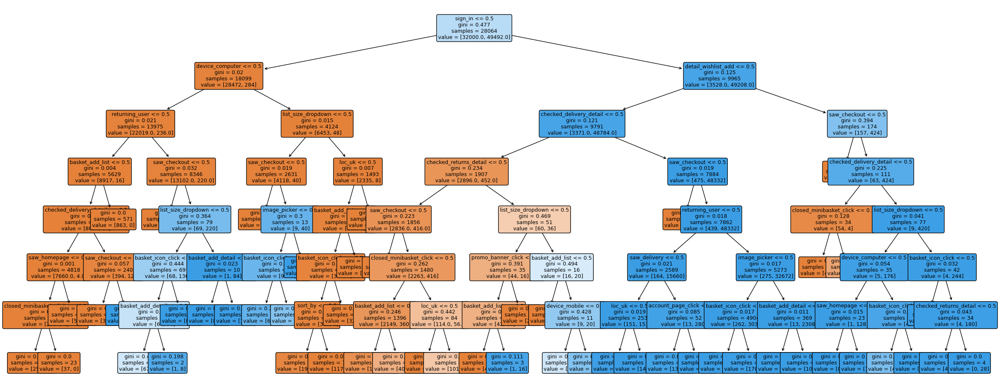

In [51]:
fig, ax = plt.subplots(figsize=(30, 12))  

plot_tree(rfc_cpu.estimators_[5], fontsize=9, filled = True, rounded = True, ax=ax, feature_names=rfc_cpu.feature_names_in_ )

plt.show()


**Hyperparameteres optimalisation**

In [52]:
params_RF = {
'n_estimators': [10,100,200], # Number of trees in the random forest
# 'criterion': 'gini', # Split criterion function (default is 'gini')
'max_depth': range(6,8,1), # Maximum depth of the tree (default is None - no limit)
'min_samples_split': [2,10,30], # Minimum number of samples required to split a node (default is 2)
# 'min_samples_leaf': 1, # Minimum number of samples required to be at a leaf node (default is 1)
# 'min_weight_fraction_leaf': 0.0, # Minimum weighted fraction of the sum total of weights (of all the input samples) required to be at a leaf node (default is 0.0)
# 'max_features': ['sqrt', 'log2'], # Number of features to consider when looking for the best split (default is 'sqrt')
'max_leaf_nodes': [10,20,30,100], # Maximum number of leaf nodes (default is None - no limit)
# 'min_impurity_decrease': 0.0, # Threshold for early stopping in tree growth (default is 0.0)
# 'bootstrap': True, # Whether bootstrap samples are used when building trees (default is True)
# 'oob_score': False, # Whether to use out-of-bag samples to estimate the generalization score (default is False)
# 'n_jobs': None, # Number of jobs to run in parallel (default is None - 1 job)
# 'random_state': None, # Random seed for reproducibility (default is None)
# 'verbose': 0, # Verbosity level (default is 0 - no output)
# 'warm_start': False, # Whether to reuse the solution of the previous call to fit (default is False)
# 'class_weight': None, # Weights associated with classes (default is None)
'ccp_alpha': [0,0.05,0.1,0.15,0.20,0.25,0.3], # Complexity parameter used for Minimal Cost-Complexity Pruning (default is 0.0 - no pruning)
# 'max_samples': None, # Number of samples to draw from X to train each base estimator (default is None - draw X.shape[0] samples)
# 'monotonic_cst': None, # Monotonic constraint (default is None - no constraint)
}

In [53]:
with joblib.parallel_backend('dask'):
    res, results = do_HPO(
          model = rfc_cpu,
          gridsearch_params = params_RF,
          X = X_Train,
          y = y_train,
          mode ='cpu-grid',
          scorer = None,
          n_iter = 10
      )

cpu-grid selected
Searched over 504 parameters

Best parameters: {'ccp_alpha': 0, 'max_depth': 7, 'max_leaf_nodes': 100, 'min_samples_split': 2, 'n_estimators': 100}
Best estimator and score RandomForestClassifier(ccp_alpha=0, class_weight={0: 1, 1: 4}, max_depth=7,
                       max_leaf_nodes=100, n_jobs=-1, random_state=42) 0.9861627784285156
---



### Ridge Classifier

In [54]:
model_RG = RidgeClassifierCV() # It rises an error given CV. Error?
model_RG

RidgeClassifierCV()

In [55]:
model_RG.fit(X_Train,y_train)

RidgeClassifierCV()

In [56]:
model_RG.score(X_Test,y_test)

0.9707950243374798

In [57]:
y_pred = model_RG.predict(X_Test)

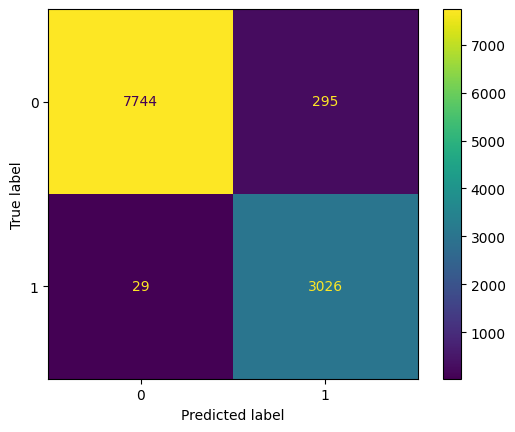

In [58]:
cmtrx = confusion_matrix(y_test, y_pred, labels=model_RG.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=model_RG.classes_)
disp.plot()
plt.show()

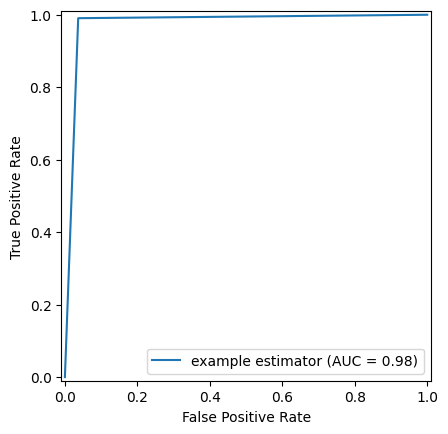

In [59]:
plot_roc_curve(y_test, y_pred)

### SGDClassifier

In [60]:
model_SGD = SGDClassifier(loss='hinge',
                          penalty='l2',
                          alpha=0.0001,
                          shuffle=True,
                          n_jobs=-1,
                          learning_rate='optimal',
                          eta0=0.0,
                          power_t=0.5,
                          early_stopping=True,
                          validation_fraction=0.1,
                          n_iter_no_change = 10,
                          average=False,
                          random_state=42
                          )
model_SGD

SGDClassifier(early_stopping=True, n_iter_no_change=10, n_jobs=-1,
              random_state=42)

In [61]:
model_SGD.fit(X_Train,y_train)

SGDClassifier(early_stopping=True, n_iter_no_change=10, n_jobs=-1,
              random_state=42)

In [62]:
model_SGD.score(X_Test,y_test)

0.9844961240310077

In [63]:
y_pred = model_SGD.predict(X_Test)

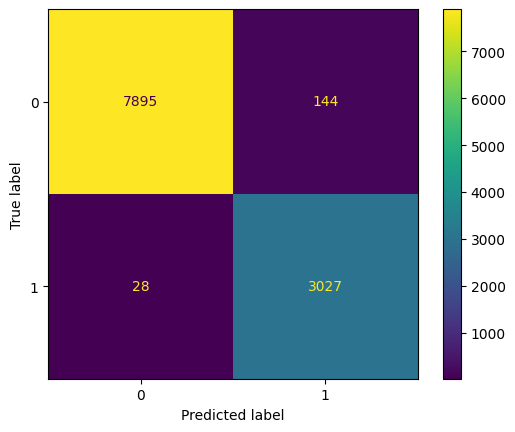

In [64]:
cmtrx = confusion_matrix(y_test, y_pred, labels=model_SGD.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=model_SGD.classes_)
disp.plot()
plt.show()

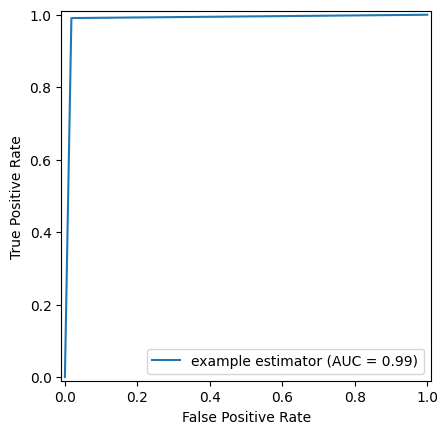

In [65]:
plot_roc_curve(y_test, y_pred)

### HistGradientBoostingClassifier

In [66]:
model_HGBC = HistGradientBoostingClassifier(learning_rate=0.1,
                                            max_iter=100,
                                            max_depth=6,
                                            max_leaf_nodes=10,
                                            min_samples_leaf=20,
                                            l2_regularization=0.01,
                                            max_features=1.0,
                                            max_bins=255,
                                            early_stopping = 'auto',
                                            random_state=42)
model_HGBC

HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=6,
                               max_leaf_nodes=10, random_state=42)

In [67]:
model_HGBC.fit(X_Train,y_train)

HistGradientBoostingClassifier(l2_regularization=0.01, max_depth=6,
                               max_leaf_nodes=10, random_state=42)

In [68]:
model_HGBC.score(X_Test,y_test)

0.9843158464034614

In [69]:
y_pred = model_HGBC.predict(X_Test)

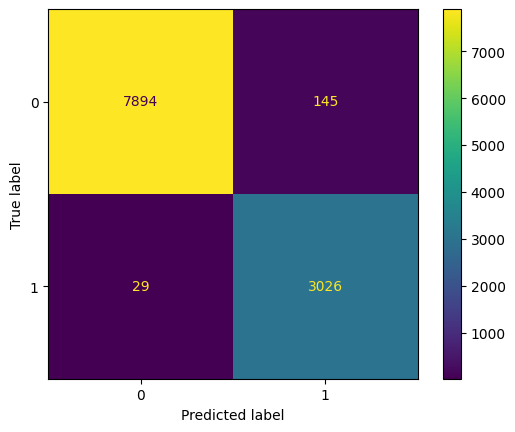

In [70]:
cmtrx = confusion_matrix(y_test, y_pred, labels=model_HGBC.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=model_HGBC.classes_)
disp.plot()
plt.show()

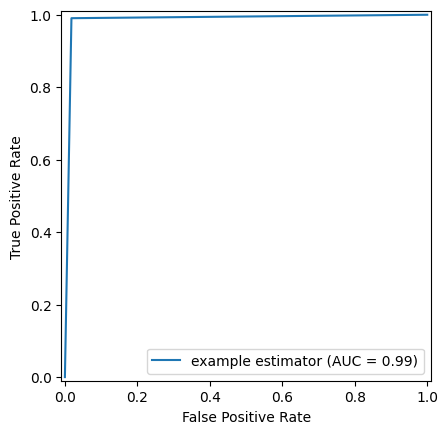

In [71]:
plot_roc_curve(y_test, y_pred)


### Support Vector Machines (SVC)

In [72]:
model_SVM = SVC(C=1.0,
                kernel='rbf',
                degree=3,
                gamma='auto',
                class_weight=lr_weight,
                random_state=42)
model_SVM

SVC(class_weight={0: 1, 1: 4}, gamma='auto', random_state=42)

In [73]:
with joblib.parallel_backend('dask'):
    model_SVM.fit(X_Train,y_train)

In [74]:
model_SVM.score(X_Test,y_test)

0.9844961240310077

In [75]:
y_pred = model_SVM.predict(X_Test)

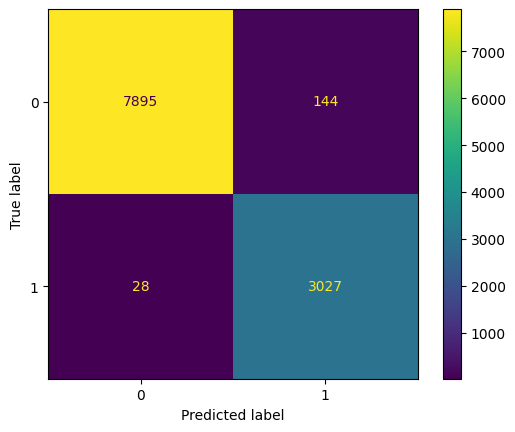

In [107]:
cmtrx = confusion_matrix(y_test, y_pred, labels=model_HGBC.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cmtrx, display_labels=model_HGBC.classes_)
disp.plot()
plt.show()

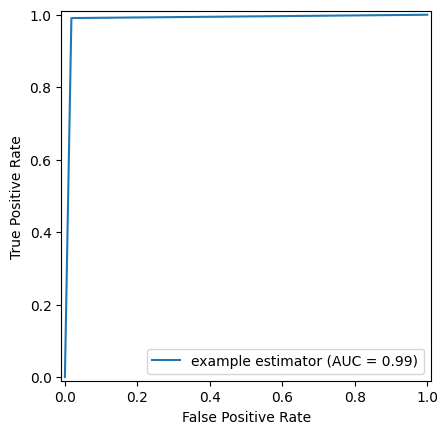

In [77]:
plot_roc_curve(y_test, y_pred)

### KNN

In [223]:
KNN = KNeighborsClassifier(n_neighbors=3, n_jobs=-1)
KNN

KNeighborsClassifier(n_jobs=-1, n_neighbors=3)

In [224]:
KNN.fit(X_Train, y_train)

KNeighborsClassifier(n_jobs=-1, n_neighbors=3)

In [225]:
KNN.score(X_Test, y_test)

0.9818820984315847

In [226]:
KNN.get_params()

{'algorithm': 'auto',
 'leaf_size': 30,
 'metric': 'minkowski',
 'metric_params': None,
 'n_jobs': -1,
 'n_neighbors': 3,
 'p': 2,
 'weights': 'uniform'}

But what is the actual number of clusters?

# Clustering and Dimentionality Reduction

In [83]:
columns_of_interest = [
     'basket_icon_click',
     'basket_add_list',
     'basket_add_detail',
     'sort_by',
     # 'image_picker',
     # 'account_page_click',
     # 'promo_banner_click',
     # 'detail_wishlist_add',
     # 'list_size_dropdown',
     # 'closed_minibasket_click',
     # 'checked_delivery_detail',
     # 'checked_returns_detail',
     # 'sign_in',
     # 'saw_checkout',
     # 'saw_sizecharts',
     # 'saw_delivery',
     # 'saw_account_upgrade',
     # 'saw_homepage',
     # 'device_mobile',
     # 'device_computer',
     # 'device_tablet',
     # 'returning_user',
     # 'loc_uk',
     # 'ordered'
]

In [84]:
# Plot Decision Boundary Subplots

@ignore_warnings(category=UserWarning)
def plot_decision_boundary_subplots(X, y, features, model=None, step=0.02, figsize=(10, 8), cmap=plt.cm.coolwarm, alpha=0.8, test_size=0.2, random_state=42):
    """
    Function to visualize decision boundaries for a binary classification problem for given pairs of features.

    Parameters:
    - X: data set (DataFrame)
    - y: class labels
    - features: list of feature names to be represented on subplots
    - model: trained classification model (default None)
    - step: step of the point grid (default 0.02)
    - figsize: graph size (default (10, 8))
    - cmap: color map for classes (default plt.cm.coolwarm)
    - test_size: test set size (default 0.2)
    - random_state: randomness seed (default 42)
    """

    def make_meshgrid(x, y, h):
        x_min, x_max = x.min() - 1, x.max() + 1
        y_min, y_max = y.min() - 1, y.max() + 1
        xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
        return xx, yy

    def plot_contours(ax, clf, xx, yy, **params):
        Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
        Z = Z.reshape(xx.shape)
        out = ax.contourf(xx, yy, Z, **params)
        return out

    def create_X(X, feature_1, feature_2):
        df = X.iloc[:, [feature_1, feature_2]]
        return df

    def features_combinations(features):
        return list(combinations_with_replacement(range(len(features)), 2))


    # create the model if not provided
    if model is None:
        model = LogisticRegression(random_state=random_state)

    # prepare the subplots
    n_features = len(features)
    fig, axes = plt.subplots(nrows=n_features, ncols=n_features, figsize=figsize)

    for i, j in features_combinations(features):
        ax1 = axes[i, j]
        ax2 = axes[j, i]

        if i == j:
            # diagonal subplots remain empty
            ax1.axis('off')
            ax2.axis('off')
        else:
            feature_1_name = features[i]
            feature_2_name = features[j]

            X_selected = create_X(X, i, j)

            # division into training and test collection
            X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=test_size, random_state=random_state)

            # Train the model
            model_ij = model.__class__(**model.get_params()).fit(X_train, y_train)

            # prepare the mesh
            xx, yy = make_meshgrid(X_selected.iloc[:, 0], X_selected.iloc[:, 1], step)

            plot_contours(ax1, model_ij, xx, yy, cmap=cmap, alpha=alpha)
            plot_contours(ax2, model_ij, yy, xx, cmap=cmap, alpha=alpha)

            # Plot the train and test data on the subplots ax1
            ax1.scatter(X_train.iloc[:, 0], X_train.iloc[:, 1], c=y_train, cmap=cmap, edgecolors='k', s=[200 for n in range(len(y_train))], linewidths=0.5)
            ax1.scatter(X_test.iloc[:, 0], X_test.iloc[:, 1], c=y_test, cmap=cmap, edgecolors='k', marker='*', s=[100 for n in range(len(y_test))], linewidths=0.5)

            # Plot the train and test data on the subplots ax2
            ax2.scatter(X_train.iloc[:, 1], X_train.iloc[:, 0], c=y_train, cmap=cmap, edgecolors='k', s=[200 for n in range(len(y_train))], linewidths=0.5)
            ax2.scatter(X_test.iloc[:, 1], X_test.iloc[:, 0], c=y_test, cmap=cmap, edgecolors='k', marker='*', s=[100 for n in range(len(y_test))], linewidths=0.5)

            # Calculate the model score on the test set and add it to the title of the subplots
            y_pred = model_ij.predict(X_test)
            score = accuracy_score(y_test, y_pred)
            ax1.set_title(f"Score: {score:.2f}")
            ax2.set_title(f"Score: {score:.2f}")

    # Add axis descriptions for subplots in the first column
    for i in range(n_features):
        ax = axes[i, 0]
        ax.set_ylabel(features[i])

    # Add axis descriptions for subplots in the first columnc
    for j in range(n_features):
        ax = axes[n_features-1, j]
        ax.set_xlabel(features[j])

    # Add axis descriptions for subplots in the first columnc
    axes[0, 1].set_ylabel(features[0])
    # axes[0, 1].set_xlabel(features[1])
    # axes[n_features-1, n_features-2].set_ylabel(features[n_features-1])
    axes[n_features-2, n_features-1].set_xlabel(features[n_features-1])

    # Add axis descriptions for subplots in the first columnc
    handles, labels = ax1.get_legend_handles_labels()
    fig.legend(handles, ['Train', 'Test'], loc='lower right')

    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Dostosuj położenie tytułu wykresu
    plt.show()


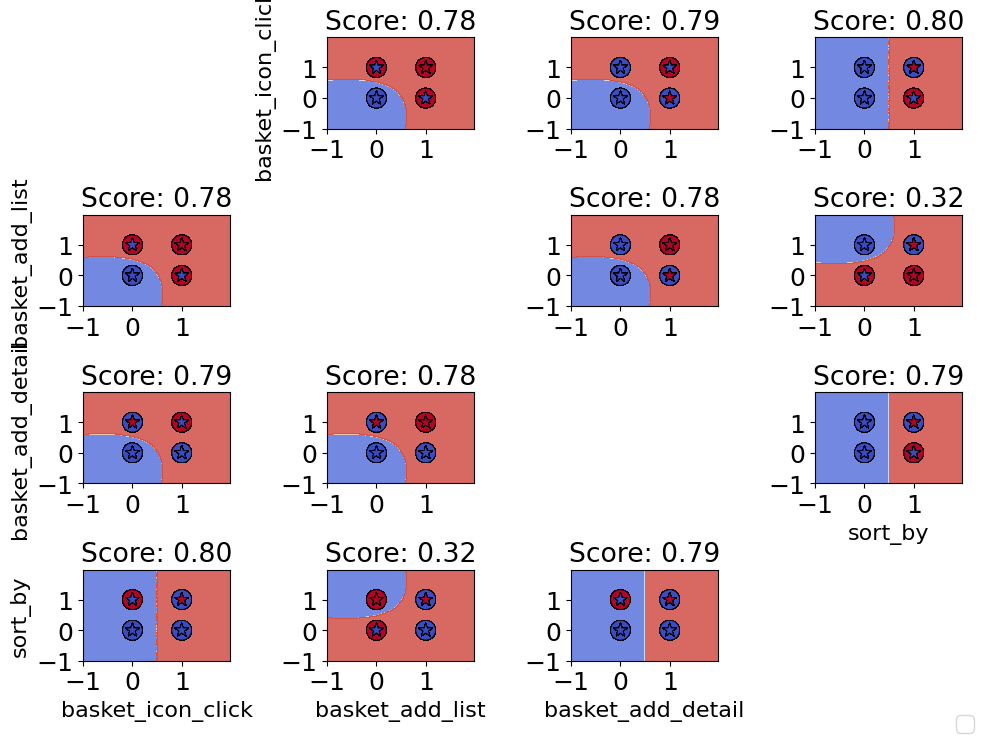

In [229]:
plot_decision_boundary_subplots(X, y, model = model_SVM, features = columns_of_interest, step=0.02)

### Dimentionality reduction

####  PCA + KMeans

##### PCA Visual Inspection

**Reduction to 2 dimensions**

In [86]:
pca_dim2 = PCA(n_components=2, random_state=random_state)
components_dim2 = pca_dim2.fit_transform(X_Train)

In [87]:
components_dim2

array([[-0.10179841, -0.85398185],
       [-0.6948713 , -0.65830537],
       [-0.79582365, -0.32919581],
       ...,
       [ 0.50861854,  0.9045894 ],
       [-0.70373064, -0.57630191],
       [-0.76682564, -0.53001385]])

In [88]:
fig = px.scatter(components_dim2, x=0, y=1, color=y_train)
fig.show()

**Reduction to 3 dimensions**

In [89]:
pca_dim3 = PCA(random_state=random_state)
components_dim3 = pca_dim3.fit_transform(X_Train)

In [90]:
fig = px.scatter_3d(
    components_dim3, x=0, y=1, z=2, color=y_train, width=1500, height=800
)
fig.show()

**All dimensions - Feature explanation**

In [91]:
pca_all = PCA(random_state=random_state)
components_all = pca_all.fit_transform(X_Train)

In [92]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca_all.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components_all,
    labels=labels,
    dimensions=range(len(pca_all.explained_variance_ratio_)),
    color=y_train,
    width=3000,
    height=3000
)
fig.update_traces(diagonal_visible=False)
fig.show()

### Descriptive PCA Analysis - Feature Importance

In [93]:
def PCA_Analysis(X_Train, random_state=25, n_components=None, to_return=False):
    pca = PCA(n_components=n_components, random_state=random_state)
    pca.fit_transform(X_Train)

    # Check explained variance
    explained_variance_ratio = pca.explained_variance_ratio_
    for i, ratio in enumerate(explained_variance_ratio):
        print(f'PC{i+1}: {round(ratio*100, 2)}%')

    sum_of_rates = 0
    i = 0
    while sum_of_rates < 0.95:
        sum_of_rates += pca.explained_variance_ratio_[i]
        i += 1
        if sum_of_rates > 0.95:
            print(f"\nNumber of dimensions to reach 95% of explained variance: {i}\n")

    # Check the components
    components = pca.components_

    # Sum of the absolute values of the components
    feature_importance = np.abs(components).sum(axis=0)

    # Vreate a table with feature importance
    feature_names = X_Train.columns
    importance_table = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importance})
    importance_table = importance_table.sort_values('Importance', ascending=False)

    print("Feature importance table:")
    print(importance_table)

    # Create a dictionary with feature names as keys and importance values as values
    importance_dict = dict(zip(importance_table['Feature'], importance_table['Importance']))

    # Sort names of features
    sorted_features = sorted(importance_dict, key=importance_dict.get, reverse=True)

    # Create a sorted matrix of components
    pca_components_sorted = pca.components_[:, [X_Train.columns.tolist().index(feature) for feature in sorted_features]]

    fig, ax = plt.subplots(figsize=(12, 10))
    sns.heatmap(pca_components_sorted, annot=True, ax=ax, annot_kws={'size': 6}, cmap=LinearSegmentedColormap.from_list('custom_cmap', colors=['blue', 'lightsteelblue', 'lightsteelblue', 'red']))

    # Column names in X
    ax.set_xticks(np.arange(len(sorted_features)))
    ax.set_xticklabels(sorted_features, rotation=30, ha='right')

    # Column names in Y
    ax.set_yticks(np.arange(len(pca_components_sorted)))
    ax.set_yticklabels([f'PC{i+1} = {round(explained_variance_ratio[i], 3)}' for i in range(len(pca_components_sorted))], rotation=0, ha='right')

    plt.tight_layout()
    plt.show()

    if to_return:
        return explained_variance_ratio, importance_table, pca_components_sorted


PC1: 28.54%
PC2: 13.86%
PC3: 10.71%
PC4: 8.28%
PC5: 8.07%
PC6: 5.86%
PC7: 5.15%
PC8: 3.89%
PC9: 2.81%
PC10: 2.16%
PC11: 2.04%
PC12: 1.89%
PC13: 1.68%
PC14: 1.49%
PC15: 1.23%
PC16: 0.74%
PC17: 0.44%
PC18: 0.39%
PC19: 0.3%
PC20: 0.23%
PC21: 0.12%
PC22: 0.1%
PC23: 0.03%

Number of dimensions to reach 95% of explained variance: 14

Feature importance table:
                    Feature  Importance
12                  sign_in    3.173888
13             saw_checkout    3.136122
0         basket_icon_click    2.635960
1           basket_add_list    2.518863
8        list_size_dropdown    2.499287
19          device_computer    2.482072
10  checked_delivery_detail    2.451360
18            device_mobile    2.419083
2         basket_add_detail    2.298319
5        account_page_click    2.215123
17             saw_homepage    2.174304
20            device_tablet    2.039626
21           returning_user    1.962071
3                   sort_by    1.835431
7       detail_wishlist_add    1.831461
22  

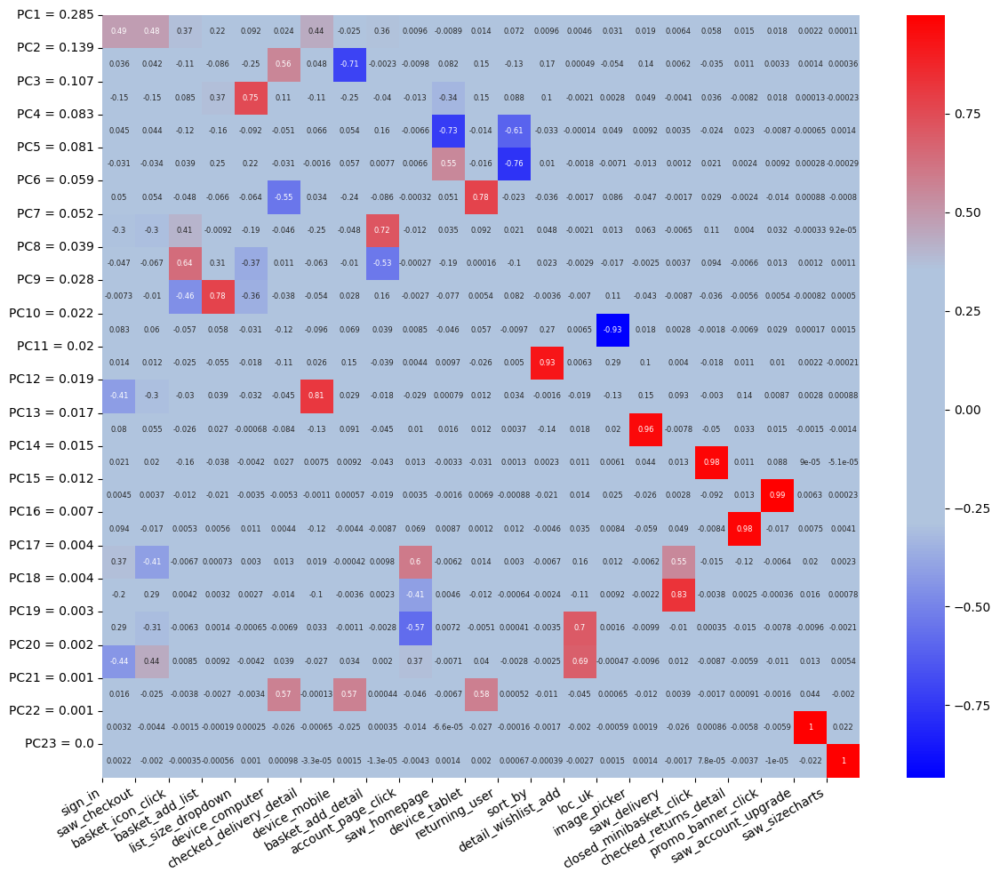

['sign_in',
 'saw_checkout',
 'basket_icon_click',
 'basket_add_list',
 'list_size_dropdown',
 'device_computer',
 'checked_delivery_detail',
 'device_mobile',
 'basket_add_detail',
 'account_page_click',
 'saw_homepage',
 'device_tablet',
 'returning_user']

In [94]:
evr, it, pca_comp = PCA_Analysis(X_Train, to_return=True)
Important_Features = it.iloc[:13,0].tolist()
Important_Features

##### Clusters on Important Features

**K-Means**

In [271]:
df_pca_red = df[Important_Features].copy()
df_pca_red.columns

Index(['sign_in', 'saw_checkout', 'basket_icon_click', 'basket_add_list',
       'list_size_dropdown', 'device_computer', 'checked_delivery_detail',
       'device_mobile', 'basket_add_detail', 'account_page_click',
       'saw_homepage', 'device_tablet', 'returning_user'],
      dtype='object')

Plot Decision Boundries

In [230]:
def plot_boundries_pca_kmeans(X_Train, n_clusters=8, random_state=25):
    pca = PCA(n_components=2, random_state=random_state)
    components = pca.fit_transform(X_Train)

    reduced_data = components
    kmeans = KMeans(init="k-means++", n_clusters=n_clusters)
    kmeans.fit(reduced_data)

    # Step size of the mesh. Decrease to increase the quality of the VQ.
    h = 0.02  # point in the mesh [x_min, x_max]x[y_min, y_max].

    # Plot the decision boundary. For that, we will assign a color to each
    x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
    y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

    # Obtain labels for each point in mesh. Use last trained model.
    Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(xx.shape)
    plt.figure(1)
    plt.clf()
    plt.imshow(
        Z,
        interpolation="nearest",
        extent=(xx.min(), xx.max(), yy.min(), yy.max()),
        cmap=plt.cm.Paired,
        aspect="auto",
        origin="lower",
    )

    plt.plot(reduced_data[:, 0], reduced_data[:, 1], "k.", markersize=2)
    # Plot the centroids as a white X
    centroids = kmeans.cluster_centers_
    plt.scatter(
        centroids[:, 0],
        centroids[:, 1],
        marker="x",
        s=169,
        linewidths=3,
        color="w",
        zorder=10,
    )
    plt.title(
        "K-means clustering on PCA-reduced data\n"
    )
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xticks(())
    plt.yticks(())
    plt.show()

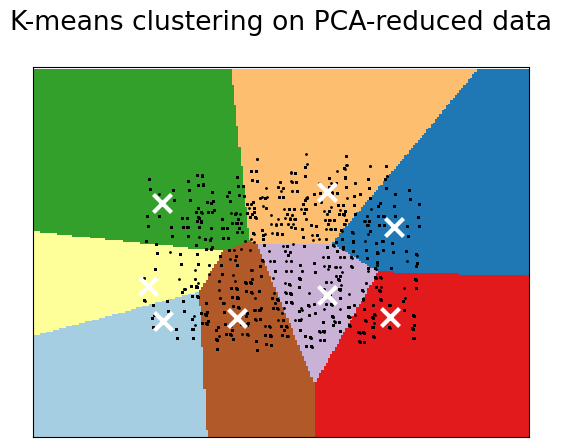

In [231]:
plot_boundries_pca_kmeans(df_pca_red, n_clusters=8, random_state=25)

SilhouetteAnalysis - own implementation

In [253]:
class SilhouetteAnalysis:
    def __init__(self, X_train, min_clusters=2, max_clusters=8, cluster_step = 1,random_state=25, print_plots=True):
        self.X_train = X_train
        self.min_clusters = min_clusters
        self.max_clusters = max_clusters
        self.cluster_step = cluster_step
        self.random_state = random_state
        self.print_plots = print_plots
        self.silhouette_scores = []
        self.pca = PCA(n_components=2, random_state=random_state)
        self.pca_comp = self.pca.fit_transform(X_train) if X_train.shape[1] > 2 else X_train.values

    def fit(self):
        range_n_clusters = range(self.min_clusters, self.max_clusters + 1, self.cluster_step)

        for n_clusters in range_n_clusters:
            clusterer = KMeans(n_clusters=n_clusters, random_state=self.random_state)
            cluster_labels = clusterer.fit_predict(self.X_train)

            silhouette_avg = silhouette_score(self.X_train, cluster_labels)
            self.silhouette_scores.append(silhouette_avg)

            print(f"For n_clusters = {n_clusters}, The average silhouette_score is : {round(silhouette_avg, 3)}")

            if self.print_plots:
                self._plot_silhouette(cluster_labels, n_clusters, silhouette_avg)

        plt.show()
        optimal_clusters = self.silhouette_scores.index(max(self.silhouette_scores)) * self.cluster_step + self.min_clusters 
        print(f'Optimal number of clusters: {optimal_clusters}')
        return optimal_clusters

    def _plot_silhouette(self, cluster_labels, n_clusters, silhouette_avg):
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        ax1.set_xlim([-0.1, 1])
        ax1.set_ylim([0, len(self.X_train) + (n_clusters + 1) * 10])

        sample_silhouette_values = silhouette_samples(self.X_train, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
            ith_cluster_silhouette_values.sort()
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper), 0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
            y_lower = y_upper + 10

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")
        ax1.set_yticks([])
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(self.pca_comp[:, 0], self.pca_comp[:, 1], marker=".", s=60, lw=0, alpha=0.7, c='black', edgecolor="k")

        self._plot_decision_boundaries(ax2, n_clusters)

        centers = KMeans(n_clusters=n_clusters, random_state=self.random_state).fit(self.pca_comp).cluster_centers_
        ax2.scatter(centers[:, 0], centers[:, 1], marker="o", c="white", alpha=1, s=300, edgecolor="k")
        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=100, edgecolor="k")

        ax2.set_title("The visualization of the clustered data.")
        plt.suptitle(f"Silhouette analysis for KMeans clustering on sample data with n_clusters = {n_clusters}",
                     fontsize=14, fontweight='bold')

        plt.show()
        plt.close(fig)

    def _plot_decision_boundaries(self, ax, n_clusters):
        x_min, x_max = self.pca_comp[:, 0].min() - 1, self.pca_comp[:, 0].max() + 1
        y_min, y_max = self.pca_comp[:, 1].min() - 1, self.pca_comp[:, 1].max() + 1
        xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.02),
                             np.arange(y_min, y_max, 0.02))

        kmeans = KMeans(n_clusters=n_clusters, random_state=self.random_state).fit(self.pca_comp)
        Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

        Z = Z.reshape(xx.shape)
        colors = [cm.nipy_spectral(float(i) / n_clusters) for i in range(n_clusters)]
        cmap = ListedColormap(colors)
        ax.contourf(xx, yy, Z, cmap=cmap, alpha=0.3)



In [272]:
# Performing Silhouette Analysis on sample of 5000 rows
silhouette = SilhouetteAnalysis(df_pca_red.sample(n=5000), min_clusters=10, max_clusters=200, cluster_step = 10,random_state=25,  print_plots=False)
optimal_clusters = silhouette.fit()

For n_clusters = 10, The average silhouette_score is : 0.265
For n_clusters = 20, The average silhouette_score is : 0.377
For n_clusters = 30, The average silhouette_score is : 0.426
For n_clusters = 40, The average silhouette_score is : 0.487
For n_clusters = 50, The average silhouette_score is : 0.526
For n_clusters = 60, The average silhouette_score is : 0.554
For n_clusters = 70, The average silhouette_score is : 0.598
For n_clusters = 80, The average silhouette_score is : 0.628
For n_clusters = 90, The average silhouette_score is : 0.656
For n_clusters = 100, The average silhouette_score is : 0.678
For n_clusters = 110, The average silhouette_score is : 0.701
For n_clusters = 120, The average silhouette_score is : 0.72
For n_clusters = 130, The average silhouette_score is : 0.736
For n_clusters = 140, The average silhouette_score is : 0.753
For n_clusters = 150, The average silhouette_score is : 0.768
For n_clusters = 160, The average silhouette_score is : 0.781
For n_clusters = 1

The Silhouette score is constantli rising, indicading, that more clusters can explain more variance. Other Method will be checked

##### Evaluation using clustereval

[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[kmeans], metric=[minkowski], linkage=[complete]
[clusteval] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 148/148 [01:04<00:00,  2.29it/s]
[clusteval] >INFO> Optimal number clusters detected: [148].
[clusteval] >INFO> Fin.


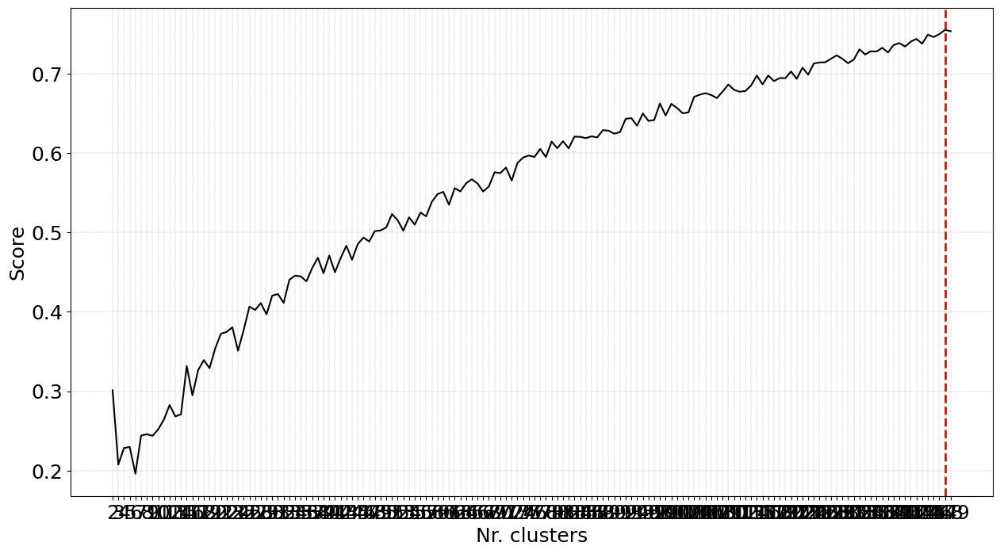

(<Figure size 1500x800 with 1 Axes>,
 <Axes: xlabel='Nr. clusters', ylabel='Score'>)

In [273]:
# Evaluation using clusteval
ce = clusteval(evaluate='silhouette',
                cluster='kmeans',
                metric='minkowski',
                linkage='complete',
                min_clust=2,
                max_clust=150,
                verbose='info')

# Fit
ce.fit(df_pca_red.sample(n=5000))

# Plot
ce.plot()

The achieved results are similar to those achived by own method. KMeans is not able to cluster the data well. 

Next HDBScan will be used, because it takes aproach based on density of the data rather than the distances.

[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[hdbscan], metric=[hamming], linkage=[complete]
[clusteval] >INFO> Estimated number of clusters: 94
[clusteval] >INFO> Silhouette Coefficient: 0.625
[clusteval] >INFO> Compute dendrogram threshold.
[clusteval] >INFO> Optimal number clusters detected: [95].
[clusteval] >INFO> Fin.
[clusteval] >INFO> Retrieving input data set.
[clusteval] >INFO> Compute t-SNE embedding.
[clusteval] >INFO> Estimated number of n_clusters: 94, average silhouette_score=0.449


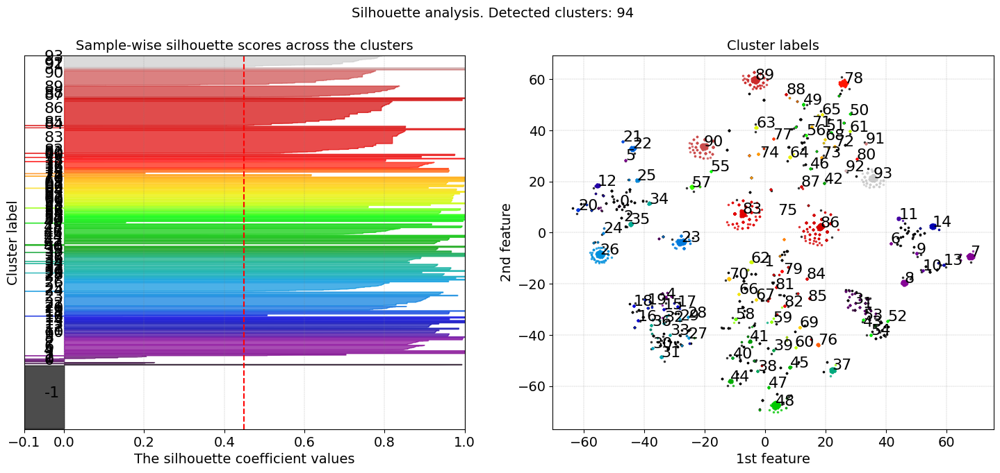

(<Figure size 1800x700 with 2 Axes>,
 <Axes: title={'center': 'Sample-wise silhouette scores across the clusters'}, xlabel='The silhouette coefficient values', ylabel='Cluster label'>,
 <Axes: title={'center': 'Cluster labels'}, xlabel='1st feature', ylabel='2nd feature'>)

In [274]:
# Evaluation using clusteval
ce = clusteval(evaluate='silhouette',
                cluster='hdbscan',
                metric='hamming',
                linkage='complete',
                min_clust=10,
                max_clust=200,
                verbose='info')

# Fit
ce.fit(df_pca_red.sample(n=5000))

# Plot Silhouette
ce.plot_silhouette(embedding='tsne',cmap='nipy_spectral')

The silhouette diagramm indicates, that the data is well separated. That could mean, that we can distinguish 95 diffirent customer behaviour based on most important features.

Because high amout of cluster was achived, the data can also be embedded first and then clustered on the low-dimensional space. Now the Euclidean distance wiil be used as a metric because our input data is not one-hot anymore but are the coordinates from the t-SNE mapping. 

[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[agglomerative], metric=[euclidean], linkage=[complete]
[clusteval] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 190/190 [01:16<00:00,  2.48it/s]
[clusteval] >INFO> Compute dendrogram threshold.
[clusteval] >INFO> Optimal number clusters detected: [199].
[clusteval] >INFO> Fin.


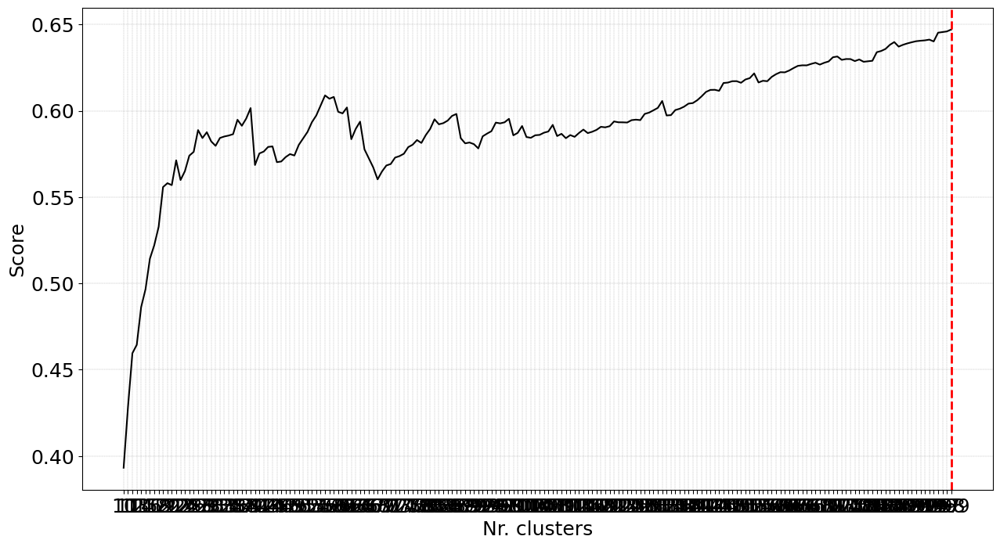

[clusteval] >INFO> Retrieving input data set.
[clusteval] >INFO> Coordinates (x, y) are set based on the first two features.
[clusteval] >INFO> Estimated number of n_clusters: 199, average silhouette_score=0.647
[clustimage] >WARNING> Colormap [tab20c] can not create [199] unique colors! Available unique colors: [20].
[clusteval] >WARNING> Colormap [tab20c] can not create [199] unique colors! Available unique colors: [20].


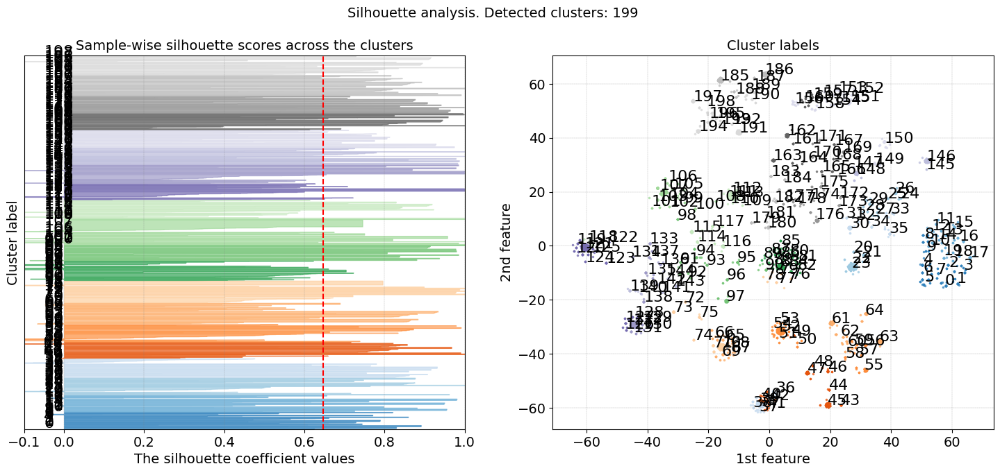

(<Figure size 1800x700 with 2 Axes>,
 <Axes: title={'center': 'Sample-wise silhouette scores across the clusters'}, xlabel='The silhouette coefficient values', ylabel='Cluster label'>,
 <Axes: title={'center': 'Cluster labels'}, xlabel='1st feature', ylabel='2nd feature'>)

In [275]:
xycoord = TSNE(n_components=2, init='random', perplexity=30).fit_transform(df_pca_red.sample(n=5000))   

# Initialize clusteval
ce = clusteval(cluster='agglomerative',
               metric='euclidean',
               linkage='complete',
               min_clust=10, max_clust=200)

# Clustering and evaluation
results = ce.fit(xycoord)

# Make plots
ce.plot()
ce.plot_silhouette()

The first diagram indicates, that the optimal (from human perspective) will be to take ca. 50 cluster. Second run will be between 40 and 70 Clusters.

t-sna provided more readable solution

[clusteval] >INFO> Saving data in memory.
[clusteval] >INFO> Fit with method=[agglomerative], metric=[euclidean], linkage=[complete]
[clusteval] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 30/30 [00:12<00:00,  2.50it/s]
[clusteval] >INFO> Compute dendrogram threshold.
[clusteval] >INFO> Optimal number clusters detected: [46].
[clusteval] >INFO> Fin.


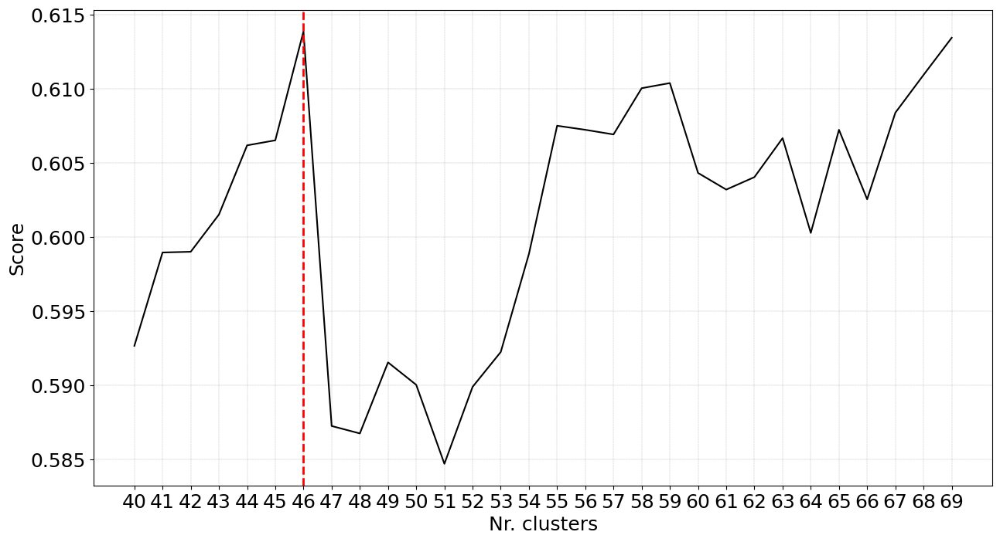

[clusteval] >INFO> Retrieving input data set.
[clusteval] >INFO> Coordinates (x, y) are set based on the first two features.
[clusteval] >INFO> Estimated number of n_clusters: 46, average silhouette_score=0.614
[clustimage] >WARNING> Colormap [tab20c] can not create [46] unique colors! Available unique colors: [20].
[clusteval] >WARNING> Colormap [tab20c] can not create [46] unique colors! Available unique colors: [20].


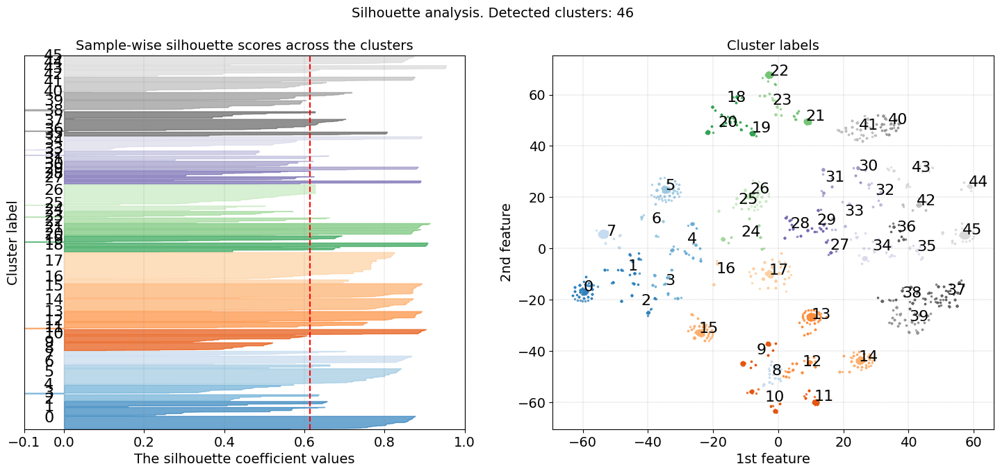

(<Figure size 1800x700 with 2 Axes>,
 <Axes: title={'center': 'Sample-wise silhouette scores across the clusters'}, xlabel='The silhouette coefficient values', ylabel='Cluster label'>,
 <Axes: title={'center': 'Cluster labels'}, xlabel='1st feature', ylabel='2nd feature'>)

In [276]:
xycoord = TSNE(n_components=2, init='random', perplexity=30).fit_transform(df_pca_red.sample(n=5000))   

# Initialize clusteval
ce = clusteval(cluster='agglomerative',
               metric='euclidean',
               linkage='complete',
               min_clust=40, max_clust=70)

# Clustering and evaluation
results = ce.fit(xycoord)

# Make plots
ce.plot()
ce.plot_silhouette()

This solution is opticaly the best of all provided.

Ponizsza funkcja plotuje ladnie wyniki rzutu PCA z zastosowaniem K-Means

# SHAPLEY

In [297]:
# Spliting the data into X and y train/test variables
X = df.iloc[:,:-1].copy()
X = X[Important_Features]
y = df.iloc[:,-1].copy()

# Oversampling
oversampler = SMOTE(random_state=42)
X_resampled_over, y_resampled_over = oversampler.fit_resample(X,y)
print('Before oversampling:', Counter(y))
print('After oversamplingu:', Counter(y_resampled_over))


X_Train, X_Test, y_train, y_test = train_test_split(X_resampled_over, y_resampled_over, test_size=0.2, random_state=42, stratify=y_resampled_over)

Before oversampling: Counter({0: 40193, 1: 15274})
After oversamplingu: Counter({1: 40193, 0: 40193})


In [298]:
# Inicjalizacja klasyfikatora XGBoost
model = xgb.XGBClassifier(
    objective='binary:logistic',
    n_estimators=100,
    max_depth=8,
    learning_rate=0.1,
    tree_method='hist',
    device='cpu',
    use_label_encoder=False,
    random_state=random_state,
    eval_metric='logloss',

)

# Trenowanie modelu
model.fit(X_Train, y_train)

# Predykcja na zbiorze testowym
y_pred = model.predict(X_Test)
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.99


In [299]:
shap.initjs()

In [300]:
# Reduce the number of samples for faster computation using shap.sample
explainer = shap.TreeExplainer(model, X_Test)
shap_values = explainer(X_Test)
shap_values

 99%|===================| 15966/16078 [00:49<00:00]        

.values =
array([[-3.11800221e-01,  6.36170809e+00,  1.81920268e-01, ...,
         1.17866764e-01,  2.45316137e-03, -4.89572709e-02],
       [-3.31663842e-01,  5.99268912e+00,  9.38637341e-02, ...,
         1.14986272e-01, -6.44127653e-02, -2.57248461e-01],
       [-4.97538946e-01,  6.18136562e+00, -3.42439194e-02, ...,
         2.44124038e-01, -1.55511416e-02, -2.01698028e-01],
       ...,
       [ 3.49641722e-01, -5.47651958e+00, -3.62822336e-02, ...,
         5.16224990e-02, -1.03296517e-02,  5.56978203e-02],
       [ 3.66655782e-01, -5.03493550e+00, -6.30703851e-02, ...,
        -5.25828197e-02, -1.29418951e-02, -1.20110432e-01],
       [ 4.16474365e-01, -5.36099605e+00, -5.22242179e-02, ...,
         4.62929582e-02, -1.26458850e-02,  4.43057467e-02]])

.base_values =
array([-3.54352847, -3.54352847, -3.54352847, ..., -3.54352847,
       -3.54352847, -3.54352847])

.data =
array([[1, 1, 1, ..., 1, 0, 0],
       [1, 1, 1, ..., 1, 0, 0],
       [1, 1, 0, ..., 1, 0, 0],
       ...,
  

In [301]:
np.shape(shap_values)

(16078, 13)

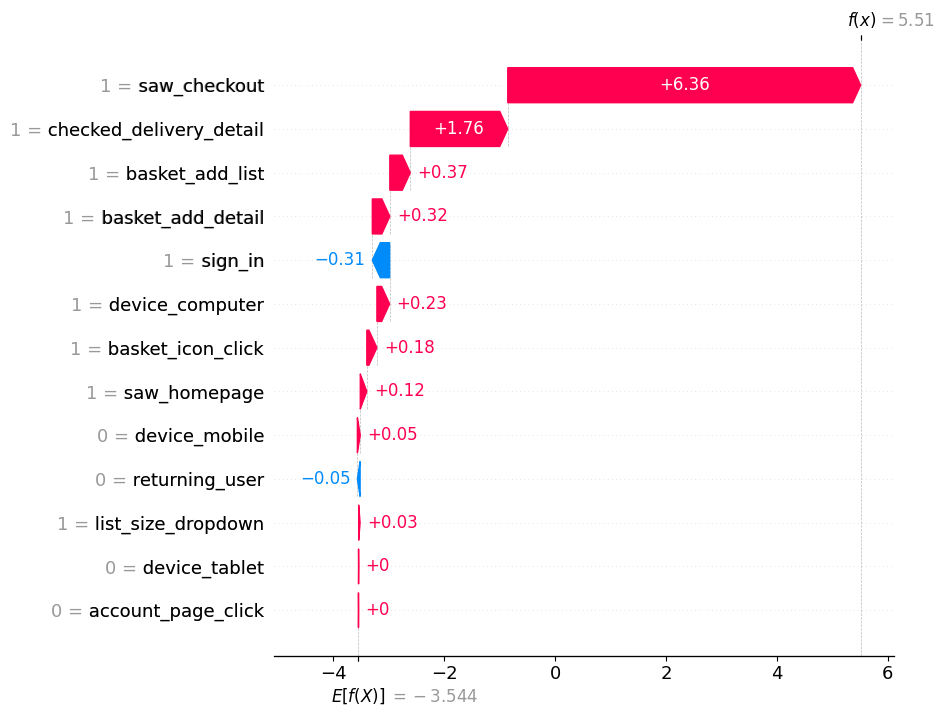

In [302]:
shap.plots.waterfall(shap_values[0],max_display=25)

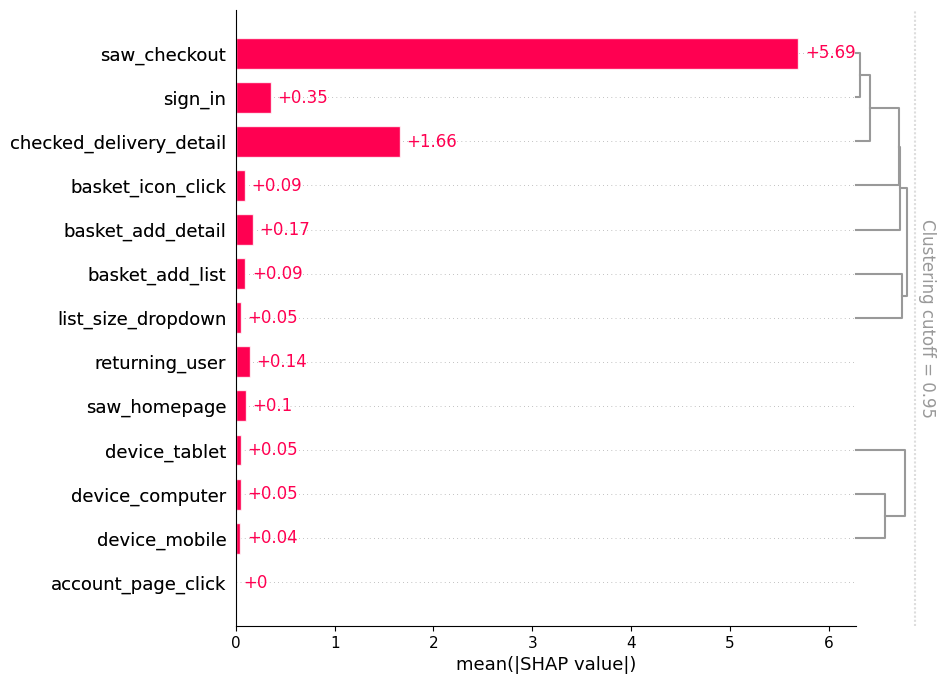

In [303]:
clustering = shap.utils.hclust(X_Test, y_test)
shap.plots.bar(shap_values, clustering=clustering, clustering_cutoff=0.95, max_display=25)

 98%|===================| 15791/16078 [00:49<00:00]        

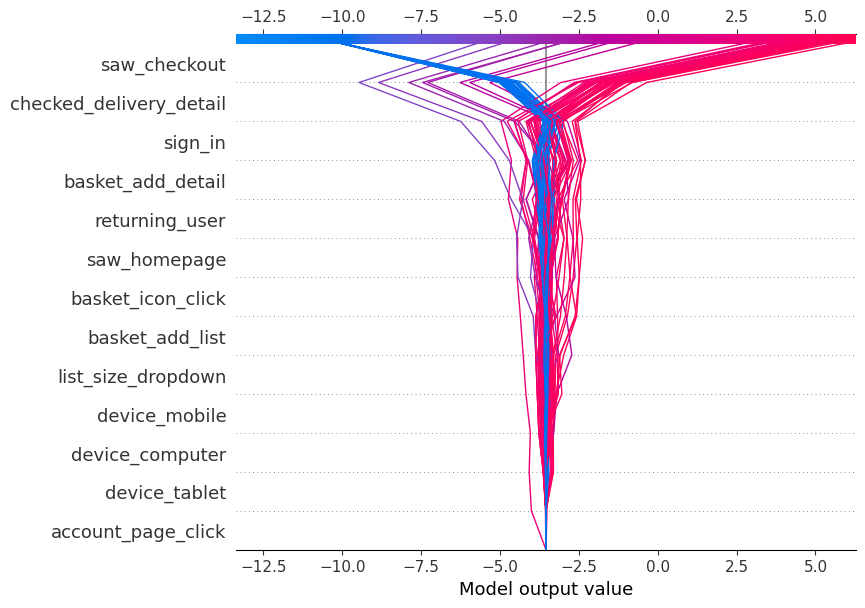

In [304]:
shap_values_decision = explainer.shap_values(X_Test)
X_Test_sample = X_Test.iloc[:100]  # First 100 samples
shap_values_sample = shap_values_decision[:100]  # First 100 samples from shap_values

# Create decision plot
shap.plots.decision(explainer.expected_value, shap_values_sample, X_Test_sample, ignore_warnings=True)



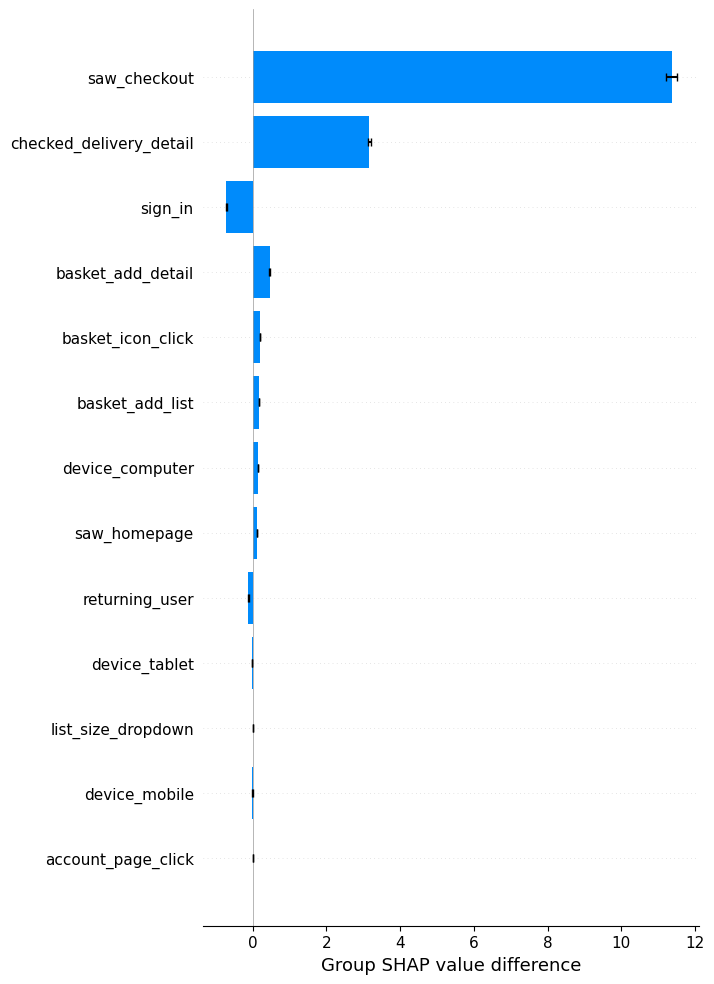

In [308]:
shap.plots.group_difference(shap_values_decision, y_test, feature_names=X_Test.columns.tolist())

In [309]:
shap.force_plot(shap_values[0])


In [310]:
shap.force_plot(shap_values[0:100])

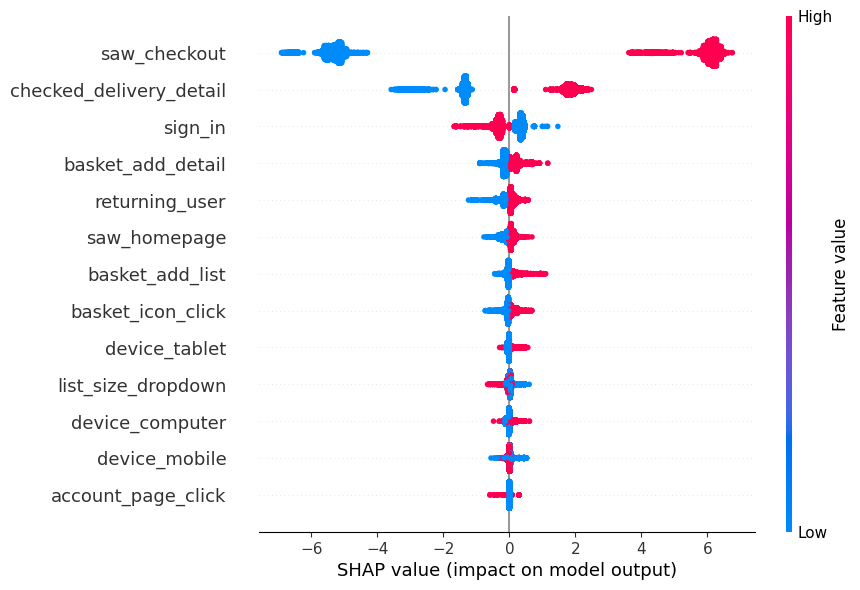

In [311]:
shap.plots.beeswarm(shap_values, max_display=25)

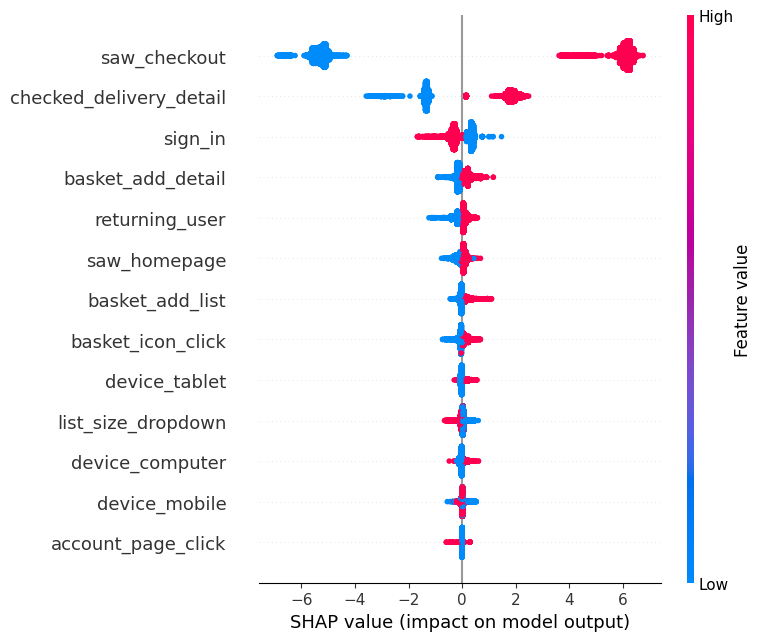

In [312]:
shap.summary_plot(shap_values, X_Test)

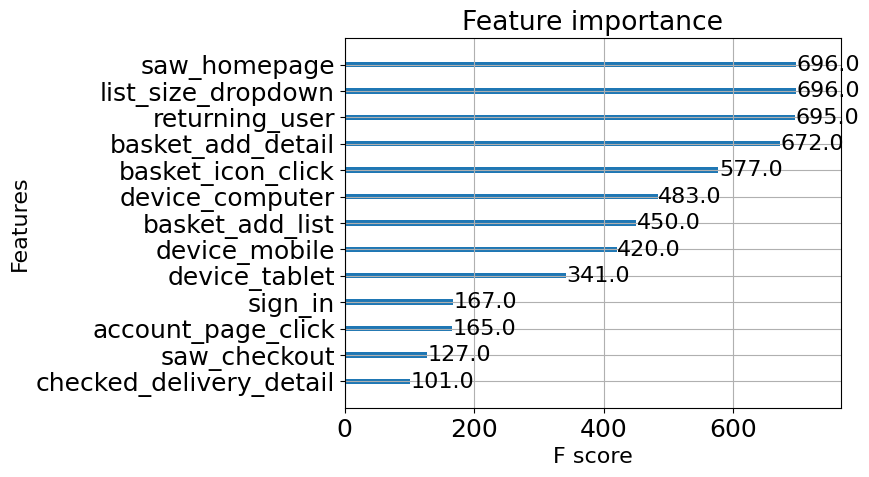

In [313]:
# Ewentualne wyświetlenie istotności cech w formie słupków
xgb.plot_importance(model)
plt.show()